In [1]:
import pandas as pd

# Load the CSV file
data = pd.read_csv('for_chris.csv')

# Extract column 1 into a series named actual
actual = data.iloc[:, 0]

# Extract column 2 into a series named predicted
predicted = data.iloc[:, 1]

In [19]:
import pandas as pd
import numpy as np
import plotly.express as px
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import scipy.stats as stats
import matplotlib.pyplot as plt


## **Plotting Actual vs Predicted**

In [5]:
# 1. Plot Actual vs. Predicted
def plot_actual_vs_predicted(actual, predicted):
    df = pd.DataFrame({'Actual': actual, 'Predicted': predicted})
    fig = px.line(df, y='Actual', title='Actual vs Predicted', labels={'value': 'Value', 'index': 'Index'})
    fig.add_scatter(x=df.index, y=df['Predicted'], mode='markers', name='Predicted', marker=dict(size=8))
    fig.show()

In [ ]:
plot_actual_vs_predicted(actual, predicted)

## **Error Metrics**

In [9]:
def calculate_error_metrics(actual, predicted):
    # Avoid division by zero for MAPE
    actual_nonzero = actual.replace(0, np.nan)  # Replace 0s with NaN
    mape = np.mean(np.abs((actual_nonzero - predicted) / actual_nonzero)) * 100

    # Other metrics
    mse = mean_squared_error(actual, predicted)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(actual, predicted)
    r2 = r2_score(actual, predicted)

    metrics = {
        'MSE': mse,
        'RMSE': rmse,
        'MAE': mae,
        'MAPE': mape if not np.isnan(mape) else "N/A (contains zeroes)",
        'R²': r2,
    }
    return pd.DataFrame([metrics])

In [10]:
calculate_error_metrics(actual, predicted)

,MSE,RMSE,MAE,MAPE,R²
0,1273.361728,35.684194,16.004412,137.601299,0.880107


## **Residual Analysis**

In [11]:
# 3. Residual Analysis
def residual_analysis(actual, predicted):
    residuals = actual - predicted

    # Residual Histogram
    fig_hist = px.histogram(residuals, nbins=30, title='Histogram of Residuals', labels={'value': 'Residuals'})
    fig_hist.show()

    # Residuals vs. Actual
    fig_scatter = px.scatter(x=actual, y=residuals, title='Residuals vs Actual',
                             labels={'x': 'Actual', 'y': 'Residuals'})
    fig_scatter.add_hline(y=0, line_dash="dash", line_color="red")
    fig_scatter.show()

In [12]:
residual_analysis(actual, predicted)

## **Scatter Plot of Predicted vs Actual**

In [13]:
def scatter_predicted_vs_actual(actual, predicted):
    fig = px.scatter(x=actual, y=predicted, title='Predicted vs Actual',
                     labels={'x': 'Actual', 'y': 'Predicted'})
    fig.add_shape(type='line', x0=min(actual), x1=max(actual), y0=min(actual), y1=max(actual),
                  line=dict(color='red', dash='dash'))
    fig.show()

In [14]:
scatter_predicted_vs_actual(actual, predicted)

## **Cummulative Errror Plot**

In [15]:
def cumulative_error_plot(actual, predicted):
    residuals = actual - predicted
    cumulative_error = np.cumsum(residuals)
    fig = px.line(x=range(len(cumulative_error)), y=cumulative_error,
                  title='Cumulative Error Plot', labels={'x': 'Index', 'y': 'Cumulative Error'})
    fig.show()

In [16]:
cumulative_error_plot(actual, predicted)

## **Confidence Interval**

In [17]:
def plot_with_confidence_intervals(actual, predicted):
    residuals = actual - predicted
    std_error = np.std(residuals)
    upper_bound = predicted + 1.96 * std_error
    lower_bound = predicted - 1.96 * std_error

    df = pd.DataFrame({'Index': range(len(actual)), 
                       'Actual': actual, 'Predicted': predicted,
                       'Upper': upper_bound, 'Lower': lower_bound})
    fig = px.line(df, x='Index', y='Actual', title='Predictions with Confidence Intervals', labels={'value': 'Value'})
    fig.add_scatter(x=df['Index'], y=df['Predicted'], mode='lines', name='Predicted')
    fig.add_scatter(x=df['Index'], y=df['Upper'], mode='lines', name='Upper Bound', line=dict(dash='dash'))
    fig.add_scatter(x=df['Index'], y=df['Lower'], mode='lines', name='Lower Bound', line=dict(dash='dash'))
    fig.show()

In [18]:
plot_with_confidence_intervals(actual, predicted)

## **QQ Plot of Residuals**

In [20]:
def qq_plot_residuals(actual, predicted):
    """
    Generates a QQ Plot for the residuals of actual vs. predicted values.
    
    Parameters:
    - actual: pd.Series or np.array of actual values
    - predicted: pd.Series or np.array of predicted values
    
    Returns:
    - Displays the QQ plot.
    """
    residuals = actual - predicted
    
    # Create the QQ Plot
    stats.probplot(residuals, dist="norm", plot=plt)
    plt.title("QQ Plot of Residuals")
    plt.xlabel("Theoretical Quantiles")
    plt.ylabel("Residual Quantiles")
    plt.grid(True)
    plt.show()

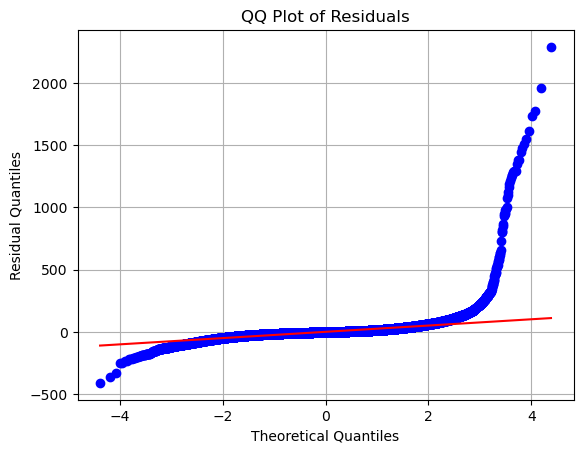

In [21]:
qq_plot_residuals(actual, predicted)